### Environment Setup & Data Loading

In [ ]:
# Import necessary libraries for deep learning and data handling
import os
import pickle
import torch
import torch.nn as nn
from torchvision import models, transforms
from torch.utils.data import DataLoader, Dataset
from PIL import Image
from tqdm import tqdm
import matplotlib.pyplot as plt



In [ ]:
# Checking if GPU is available
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
print(f"Using device: {device}")

def find_image_dir():
    """
    Search for the Flickr30k image directory within the environment.
    Kaggle ya Colab mein dataset ka path dhoondnay ke liye function.
    """
    base_input = '/kaggle/input' # Default path for Kaggle
    if not os.path.exists(base_input):
        base_input = './' # Local or Colab path

    for root, dirs, files in os.walk(base_input):
        # We look for a directory that contains many .jpg files
        if len([f for f in files if f.endswith('.jpg')]) > 1000:
            return root
    return None

IMAGE_DIR = find_image_dir()
if IMAGE_DIR:
    print(f"Found images at: {IMAGE_DIR}")
else:
    print("Dataset directory not found. Please upload or link the Flickr30k dataset.")

Using device: cuda
Dataset directory not found. Please upload or link the Flickr30k dataset.


### Step 2: Setting Kaggle Token & Downloading

In [ ]:
import kagglehub
import os

# Download the latest version of the dataset
path = kagglehub.dataset_download("adityajn105/flickr30k")

print("Path to dataset files:", path)

# List files to see the structure
print("Files in dataset:", os.listdir(path))

# Assignment requirement ke mutabiq IMAGE_DIR aur captions file path set krain
IMAGE_DIR = os.path.join(path, 'Images')
CAPTIONS_FILE = os.path.join(path, 'captions.txt')

if os.path.exists(IMAGE_DIR):
    print(f"Success! Found {len(os.listdir(IMAGE_DIR))} images.")
else:
    print("Images folder name might be different. Current contents:", os.listdir(path))

Using Colab cache for faster access to the 'flickr30k' dataset.
Path to dataset files: /kaggle/input/flickr30k
Files in dataset: ['captions.txt', 'Images']
Success! Found 31785 images.


### Feature Extraction

In [ ]:
import os
import pickle
import torch
import torch.nn as nn
from torchvision import models, transforms
from torch.utils.data import DataLoader, Dataset
from PIL import Image
from tqdm import tqdm

# Configuration and Paths
# Setting the output file name as per assignment requirements [cite: 44]
IMAGE_DIR = '/kaggle/input/flickr30k/Images'
OUTPUT_FILE = 'flickr30k_features.pkl'
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")

# Dataset Class to handle image loading and preprocessing [cite: 50]
class FlickrDataset(Dataset):
    def __init__(self, img_dir, transform):
        # Filter only jpg/jpeg images from the directory [cite: 52]
        self.img_names = [f for f in os.listdir(img_dir) if f.endswith(('.jpg', '.jpeg'))]
        self.transform = transform
        self.img_dir = img_dir

    def __len__(self):
        # Return total number of images [cite: 55]
        return len(self.img_names)

    def __getitem__(self, idx):
        # Load image, convert to RGB, and apply transformations [cite: 59]
        name = self.img_names[idx]
        img_path = os.path.join(self.img_dir, name)
        img = Image.open(img_path).convert('RGB')
        return self.transform(img), name

# Initialize ResNet50 and remove the final classification layer
# This allows us to get a 2048-dimensional feature vector [cite: 27, 81]
model = models.resnet50(weights=models.ResNet50_Weights.DEFAULT)
model = nn.Sequential(*list(model.children())[:-1])
model = nn.DataParallel(model).to(device)
model.eval()

# Image transformations: Resize to 224x224 and Normalize [cite: 64]
transform = transforms.Compose([
    transforms.Resize((224, 224)),
    transforms.ToTensor(),
    transforms.Normalize((0.485, 0.456, 0.406), (0.229, 0.224, 0.225))
])

# Prepare DataLoader [cite: 68, 69]
dataset = FlickrDataset(IMAGE_DIR, transform)
loader = DataLoader(dataset, batch_size=128, num_workers=4)
features_dict = {}

# Feature Extraction Loop [cite: 70, 71]
print("Starting feature extraction... This might take a few minutes.")
with torch.no_grad():
    for imgs, names in tqdm(loader, desc="Extracting Features"):
        # Extract features and flatten to a vector [cite: 72]
        feats = model(imgs.to(device)).view(imgs.size(0), -1)
        for i, name in enumerate(names):
            # Store features in a dictionary with filename as key [cite: 73]
            features_dict[name] = feats[i].cpu().numpy()

# Save the extracted features to a pickle file [cite: 74, 75]
with open(OUTPUT_FILE, 'wb') as f:
    pickle.dump(features_dict, f)

print(f"Success! {len(features_dict)} images processed and saved to {OUTPUT_FILE}") # [cite: 76]

/usr/local/lib/python3.12/dist-packages/torch/utils/data/dataloader.py:627: UserWarning: This DataLoader will create 4 worker processes in total. Our suggested max number of worker in current system is 2, which is smaller than what this DataLoader is going to create. Please be aware that excessive worker creation might get DataLoader running slow or even freeze, lower the worker number to avoid potential slowness/freeze if necessary.
  warnings.warn(


Starting feature extraction... This might take a few minutes.


Extracting Features: 100%|██████████| 249/249 [02:46<00:00,  1.50it/s]


Success! 31783 images processed and saved to flickr30k_features.pkl


### Vocabulary & Text Pre-Processing
we add some special token also: < pad > < end > < start > < unk >



In [ ]:
import pandas as pd
from collections import Counter
import re

# Path to the captions file
CAPTIONS_FILE = '/kaggle/input/flickr30k/captions.txt'

# Load the captions using pandas
# Flickr30k typically uses '|' as a delimiter or standard CSV format
df = pd.read_csv(CAPTIONS_FILE)

# Cleaning function to remove punctuation and lowercase the text
def clean_caption(text):
    text = str(text).lower()
    text = re.sub(r'[^a-zA-Z\s]', '', text)
    return text

# Building the Vocabulary
class Vocabulary:
    def __init__(self, freq_threshold):
        # Index to String and String to Index mapping
        self.itos = {0: "<pad>", 1: "<start>", 2: "<end>", 3: "<unk>"}
        self.stoi = {"<pad>": 0, "<start>": 1, "<end>": 2, "<unk>": 3}
        self.freq_threshold = freq_threshold

    def __len__(self):
        return len(self.itos)

    def build_vocabulary(self, sentence_list):
        frequencies = Counter()
        idx = 4

        for sentence in sentence_list:
            for word in sentence.split():
                frequencies[word] += 1

                # Add word to vocab if it meets the frequency threshold
                if frequencies[word] == self.freq_threshold:
                    self.stoi[word] = idx
                    self.itos[idx] = word
                    idx += 1

    def numericalize(self, text):
        # Convert text into a list of word IDs
        tokenized_text = text.split()
        return [
            self.stoi[token] if token in self.stoi else self.stoi["<unk>"]
            for token in tokenized_text
        ]

# Apply cleaning and build the vocabulary
df['caption'] = df['caption'].apply(clean_caption)
vocab = Vocabulary(freq_threshold=5)
vocab.build_vocabulary(df['caption'].tolist())

print(f"Vocabulary size: {len(vocab)}")
print(f"Sample mapping: 'the' -> {vocab.stoi.get('the')}")

Vocabulary size: 7689
Sample mapping: 'the' -> 12


## The Seq2Seq Architecture

In [ ]:
import torch
import torch.nn as nn

# 1. The Encoder Class
# Projects the 2048-dimensional cached vector into the hidden_size
class EncoderCNN(nn.Module):
    def __init__(self, embed_size):
        super(EncoderCNN, self).__init__()
        # Linear layer to change dimension from 2048 to hidden embedding size
        self.linear = nn.Linear(2048, embed_size)
        self.relu = nn.ReLU()
        self.dropout = nn.Dropout(0.5)

    def forward(self, features):
        # features shape: (batch_size, 2048)
        # output shape: (batch_size, embed_size)
        return self.dropout(self.relu(self.linear(features)))

# 2. The Decoder Class
# Uses an LSTM to generate words based on encoder output and word embeddings
class DecoderRNN(nn.Module):
    def __init__(self, embed_size, hidden_size, vocab_size, num_layers=1):
        super(DecoderRNN, self).__init__()
        # Embedding layer for captions
        self.embed = nn.Embedding(vocab_size, embed_size)

        # FIXED: Changed batch_size_first to batch_first
        self.lstm = nn.LSTM(embed_size, hidden_size, num_layers, batch_first=True)

        # Final linear layer to map to vocab_size for word prediction
        self.linear = nn.Linear(hidden_size, vocab_size)
        self.dropout = nn.Dropout(0.5)

    def forward(self, features, captions):
        # captions: (batch_size, seq_length)
        # Remove the <end> token from the end of captions during training
        embeddings = self.dropout(self.embed(captions[:, :-1]))

        # Concatenate image features as the first 'word' of the sequence
        # We add a dimension to features (batch_size, 1, embed_size)
        inputs = torch.cat((features.unsqueeze(1), embeddings), dim=1)

        # LSTM forward pass
        hiddens, _ = self.lstm(inputs)

        # Output layer
        outputs = self.linear(hiddens)
        return outputs

# Combining both into a single model
class CNNtoRNN(nn.Module):
    def __init__(self, embed_size, hidden_size, vocab_size, num_layers):
        super(CNNtoRNN, self).__init__()
        self.encoderCNN = EncoderCNN(embed_size)
        self.decoderRNN = DecoderRNN(embed_size, hidden_size, vocab_size, num_layers)

    def forward(self, images, captions):
        features = self.encoderCNN(images)
        outputs = self.decoderRNN(features, captions)
        return outputs

# Model Hyperparameters
embed_size = 512
hidden_size = 512
vocab_size = len(vocab)
num_layers = 1

# Initialize the model and move to GPU
model = CNNtoRNN(embed_size, hidden_size, vocab_size, num_layers).to(device)
print("Model initialized successfully!")

Model initialized successfully!


### Training Data Preparation

Check actual column names in the dataframe

In [ ]:
print("Current columns in DataFrame:", df.columns.tolist())

Current columns in DataFrame: ['image', 'caption']


In [ ]:
from torch.nn.utils.rnn import pad_sequence

class TrainDataset(Dataset):
    def __init__(self, features_dict, df, vocab):
        self.features_dict = features_dict
        self.df = df
        self.vocab = vocab

    def __len__(self):
        return len(self.df)

    def __getitem__(self, idx):
        # Get image name and caption from dataframe
        caption = self.df.iloc[idx]['caption']
        img_name = self.df.iloc[idx]['image'] # FIXED: Changed 'image_name' to 'image'

        # Get pre-extracted features
        # Humne Part 1 mein ye features save kiye thay
        feature = torch.tensor(self.features_dict[img_name])

        # Numericalize caption: <start> + text + <end>
        # Har caption ko start aur end tokens dena zaroori hai
        numericalized_caption = [self.vocab.stoi["<start>"]]
        numericalized_caption += self.vocab.numericalize(caption)
        numericalized_caption.append(self.vocab.stoi["<end>"])

        return feature, torch.tensor(numericalized_caption)

# Collate function to handle padding within each batch
def MyCollate(batch):
    # Padding token ID from our vocab
    pad_idx = 0 # <pad> is at index 0
    features = [item[0].unsqueeze(0) for item in batch]
    features = torch.cat(features, dim=0)

    targets = [item[1] for item in batch]
    targets = pad_sequence(targets, batch_first=True, padding_value=pad_idx)

    return features, targets

# Initialize Dataset and DataLoader
# Hum batch size 64 rakh rahay hain takay memory handle ho sakay
train_dataset = TrainDataset(features_dict, df, vocab)
train_loader = DataLoader(
    dataset=train_dataset,
    batch_size=64,
    shuffle=True,
    collate_fn=MyCollate
)

print("DataLoader ready for training!")

DataLoader ready for training!


### Loss Function & Optimizer Setup
we use Adam optimizer

In [ ]:
# Hyperparameters
learning_rate = 3e-4

# Loss and Optimizer
# CrossEntropy with ignore_index for <pad> token
criterion = nn.CrossEntropyLoss(ignore_index=vocab.stoi["<pad>"])
optimizer = torch.optim.Adam(model.parameters(), lr=learning_rate)

print("Loss function and Optimizer defined.")

Loss function and Optimizer defined.


### The Training Loop

In [ ]:
num_epochs = 25
loss_list = []

model.train()

for epoch in range(num_epochs):
    epoch_loss = 0
    for idx, (features, captions) in enumerate(tqdm(train_loader, desc=f"Epoch {epoch+1}")):
        features = features.to(device)
        captions = captions.to(device)

        # Forward pass
        outputs = model(features, captions)

        # Calculate loss: outputs shape (batch, seq_len, vocab_size)
        # We reshape to (batch * seq_len, vocab_size) for CrossEntropy
        loss = criterion(outputs.view(-1, outputs.shape[2]), captions.view(-1))

        epoch_loss += loss.item()

        # Backward pass and optimization
        optimizer.zero_grad()
        loss.backward()
        optimizer.step()

    avg_loss = epoch_loss / len(train_loader)
    loss_list.append(avg_loss)
    print(f"Epoch [{epoch+1}/{num_epochs}], Average Loss: {avg_loss:.4f}")

print("Training finished!")

Epoch 1: 100%|██████████| 2484/2484 [01:09<00:00, 35.84it/s]


Epoch [1/25], Average Loss: 2.2097


Epoch 2: 100%|██████████| 2484/2484 [01:09<00:00, 35.64it/s]


Epoch [2/25], Average Loss: 2.1948


Epoch 3: 100%|██████████| 2484/2484 [01:09<00:00, 35.60it/s]


Epoch [3/25], Average Loss: 2.1809


Epoch 4: 100%|██████████| 2484/2484 [01:09<00:00, 35.61it/s]


Epoch [4/25], Average Loss: 2.1677


Epoch 5: 100%|██████████| 2484/2484 [01:09<00:00, 35.66it/s]


Epoch [5/25], Average Loss: 2.1553


Epoch 6: 100%|██████████| 2484/2484 [01:09<00:00, 35.52it/s]


Epoch [6/25], Average Loss: 2.1432


Epoch 7: 100%|██████████| 2484/2484 [01:10<00:00, 35.48it/s]


Epoch [7/25], Average Loss: 2.1312


Epoch 8: 100%|██████████| 2484/2484 [01:09<00:00, 35.52it/s]


Epoch [8/25], Average Loss: 2.1199


Epoch 9: 100%|██████████| 2484/2484 [01:09<00:00, 35.49it/s]


Epoch [9/25], Average Loss: 2.1099


Epoch 10: 100%|██████████| 2484/2484 [01:11<00:00, 34.55it/s]


Epoch [10/25], Average Loss: 2.0988


Epoch 11: 100%|██████████| 2484/2484 [01:10<00:00, 35.21it/s]


Epoch [11/25], Average Loss: 2.0895


Epoch 12: 100%|██████████| 2484/2484 [01:09<00:00, 35.49it/s]


Epoch [12/25], Average Loss: 2.0803


Epoch 13: 100%|██████████| 2484/2484 [01:16<00:00, 32.68it/s]


Epoch [13/25], Average Loss: 2.0705


Epoch 14: 100%|██████████| 2484/2484 [01:12<00:00, 34.46it/s]


Epoch [14/25], Average Loss: 2.0628


Epoch 15: 100%|██████████| 2484/2484 [01:13<00:00, 33.62it/s]


Epoch [15/25], Average Loss: 2.0534


Epoch 16: 100%|██████████| 2484/2484 [01:15<00:00, 32.76it/s]


Epoch [16/25], Average Loss: 2.0452


Epoch 17: 100%|██████████| 2484/2484 [01:13<00:00, 33.69it/s]


Epoch [17/25], Average Loss: 2.0367


Epoch 18: 100%|██████████| 2484/2484 [01:14<00:00, 33.28it/s]


Epoch [18/25], Average Loss: 2.0305


Epoch 19: 100%|██████████| 2484/2484 [01:14<00:00, 33.49it/s]


Epoch [19/25], Average Loss: 2.0222


Epoch 20: 100%|██████████| 2484/2484 [01:09<00:00, 35.56it/s]


Epoch [20/25], Average Loss: 2.0144


Epoch 21: 100%|██████████| 2484/2484 [01:09<00:00, 35.67it/s]


Epoch [21/25], Average Loss: 2.0075


Epoch 22: 100%|██████████| 2484/2484 [01:09<00:00, 35.55it/s]


Epoch [22/25], Average Loss: 2.0019


Epoch 23: 100%|██████████| 2484/2484 [01:09<00:00, 35.53it/s]


Epoch [23/25], Average Loss: 1.9949


Epoch 24: 100%|██████████| 2484/2484 [01:09<00:00, 35.55it/s]


Epoch [24/25], Average Loss: 1.9885


Epoch 25: 100%|██████████| 2484/2484 [01:09<00:00, 35.60it/s]

Epoch [25/25], Average Loss: 1.9817
Training finished!


### Plotting the Loss Curve On 15 Epoch



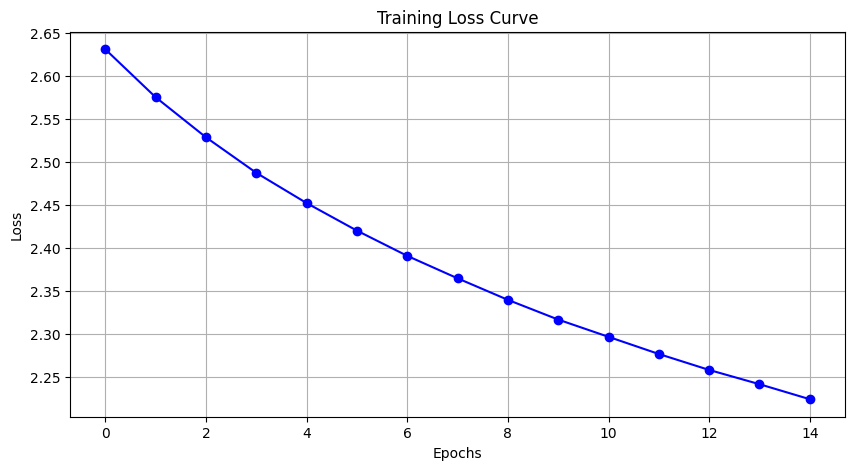

In [ ]:
import matplotlib.pyplot as plt

# Plotting the training loss over epochs
# Humein loss curve plot karni hai jaisa assignment mein manga gaya hai
plt.figure(figsize=(10, 5))
plt.plot(loss_list, marker='o', linestyle='-', color='b')
plt.title("Training Loss Curve")
plt.xlabel("Epochs")
plt.ylabel("Loss")
plt.grid(True)
plt.show()

### Plotting the Loss Curve On 25 Epoch

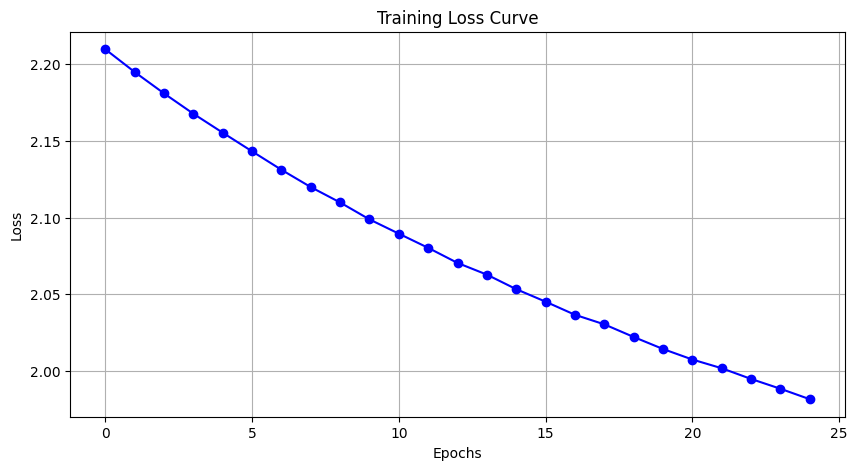

In [ ]:
import matplotlib.pyplot as plt

# Plotting the training loss over epochs
# Humein loss curve plot karni hai jaisa assignment mein manga gaya hai
plt.figure(figsize=(10, 5))
plt.plot(loss_list, marker='o', linestyle='-', color='b')
plt.title("Training Loss Curve")
plt.xlabel("Epochs")
plt.ylabel("Loss")
plt.grid(True)
plt.show()

### Inference Function (Greedy & Beam Search)

* Greedy Search: Ye har step par sirf wo word uthata hai jiski probability sab se zyada hoti hai.


* Beam Search: Ye ek sath kai rastay (sequences) check karta hai takay behtar aur lambay sentence ban sakain.

## Greedy Search Implementation

In [ ]:
def caption_image_refined(model, feature, vocab, max_length=50):
    result_caption = []
    model.eval()

    with torch.no_grad():
        feature = torch.tensor(feature).unsqueeze(0).to(device)
        encoded_feature = model.encoderCNN(feature).unsqueeze(1)
        states = None

        # Start token se shuru krain
        input_word = torch.tensor([vocab.stoi["<start>"]]).to(device).unsqueeze(0)

        for _ in range(max_length):
            if _ == 0:
                hiddens, states = model.decoderRNN.lstm(encoded_feature, states)
            else:
                embeddings = model.decoderRNN.embed(input_word)
                hiddens, states = model.decoderRNN.lstm(embeddings, states)

            output = model.decoderRNN.linear(hiddens.squeeze(1))
            predicted = output.argmax(1)

            # Agar <end> aa jaye toh ruk jayen
            if vocab.itos[predicted.item()] == "<end>":
                break

            # <start> ko result mein add na krain
            if vocab.itos[predicted.item()] != "<start>":
                result_caption.append(vocab.itos[predicted.item()])

            input_word = predicted.unsqueeze(0)

    return ' '.join(result_caption)
print("Inference function ready.")

Inference function ready.


### Visualizing Random Results

### --> On 5 epoch model test Random:

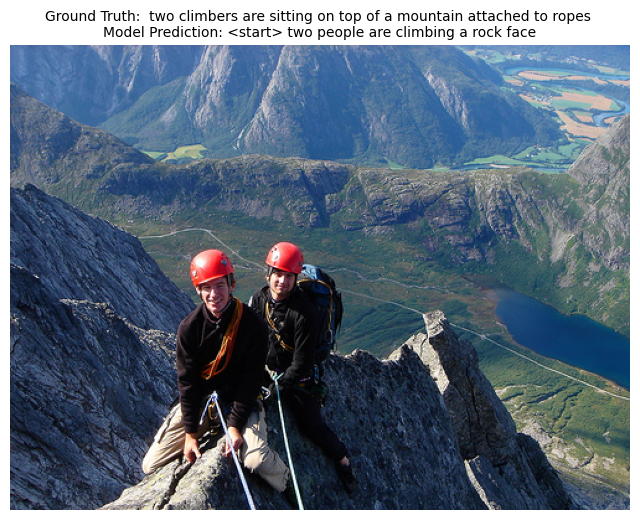

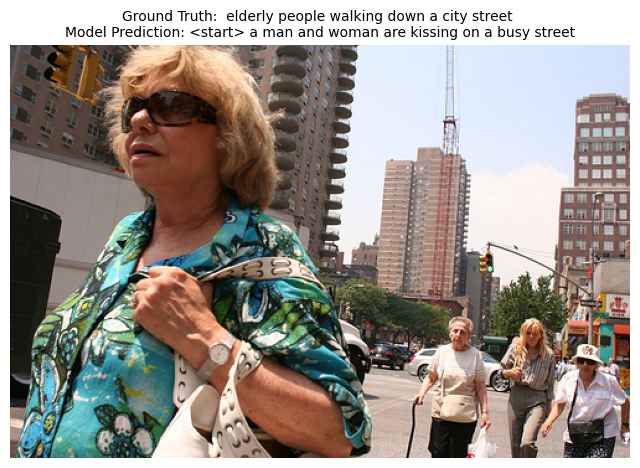

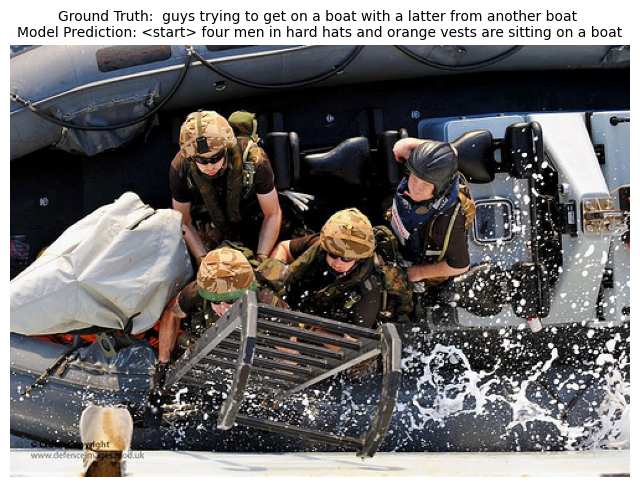

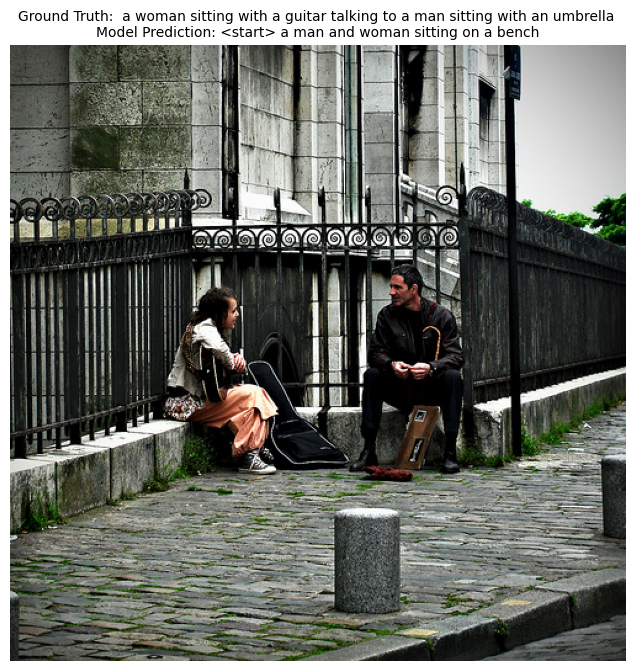

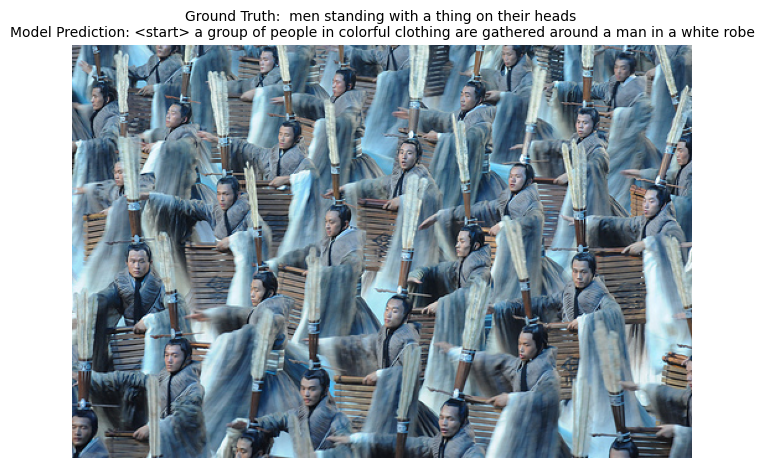

In [ ]:
import random
import os
from PIL import Image
import matplotlib.pyplot as plt

def show_random_results(df, features_dict, model, vocab, num_images=5):
    # Defining column names again to fix the NameError
    # Hum columns ke naam dobara set kar rahay hain
    img_col = 'image_name' if 'image_name' in df.columns else 'image' # [cite: 78]
    cap_col = 'caption' # [cite: 78]

    # Picking random indices from the dataframe
    random_indices = random.sample(range(len(df)), num_images)

    for idx in random_indices:
        img_name = df.iloc[idx][img_col]
        ground_truth = df.iloc[idx][cap_col]

        # Get feature and generate caption
        if img_name in features_dict:
            feature = features_dict[img_name]
            generated_caption = caption_image(model, feature, vocab)

            # Load and show the image
            # Kaggle path use kar rahay hain jahan images extract hui thin
            img_path = f'/kaggle/input/flickr30k/Images/{img_name}'

            if os.path.exists(img_path):
                img = Image.open(img_path)
                plt.figure(figsize=(8, 8))
                plt.imshow(img)
                plt.title(f"Ground Truth: {ground_truth}\nModel Prediction: {generated_caption}", fontsize=10)
                plt.axis("off")
                plt.show()
            else:
                print(f"Image file not found: {img_path}")
        else:
            print(f"Features for {img_name} not found in dictionary.")

# Run the visualization
show_random_results(df, features_dict, model, vocab)

### --> On 15 epoch Test model random:

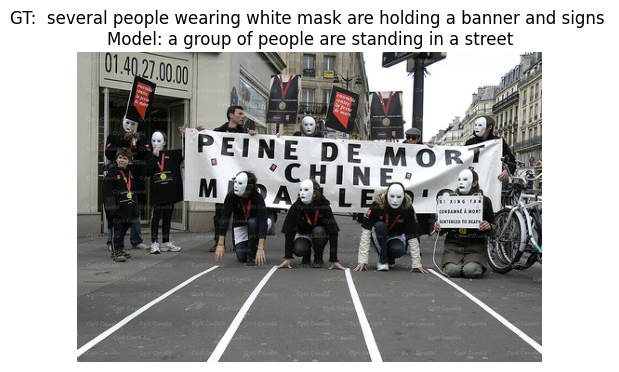

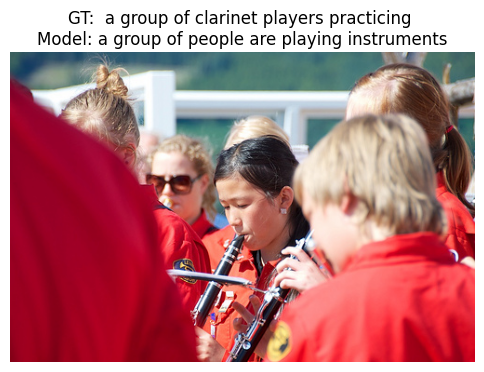

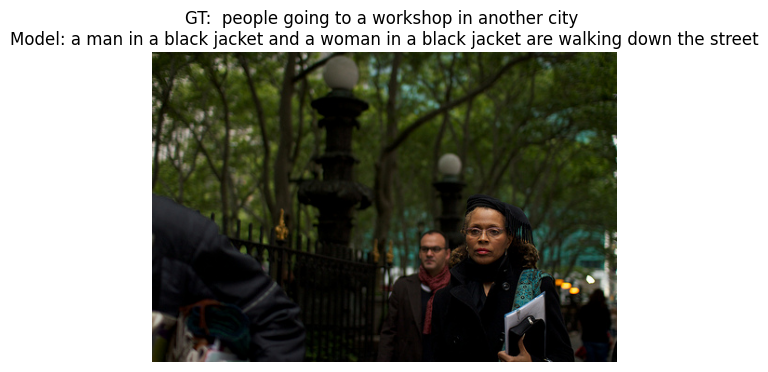

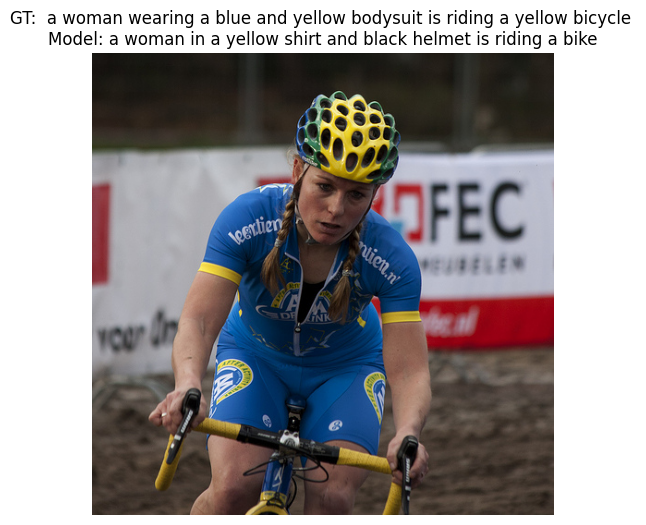

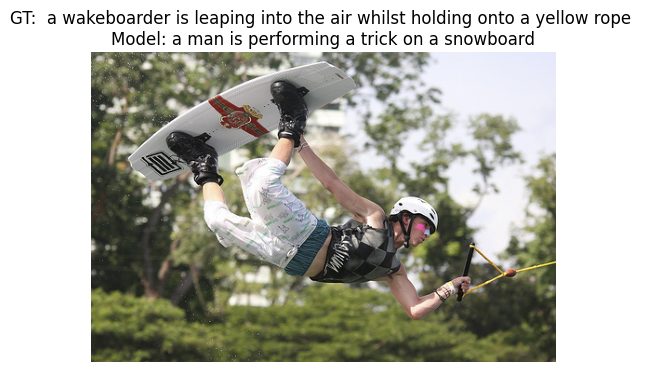

In [ ]:
def show_random_results_refined(df, features_dict, model, vocab, num_images=5):
    img_col = 'image_name' if 'image_name' in df.columns else 'image'
    cap_col = 'caption'

    random_indices = random.sample(range(len(df)), num_images)

    for idx in random_indices:
        img_name = df.iloc[idx][img_col]
        ground_truth = df.iloc[idx][cap_col]

        if img_name in features_dict:
            feature = features_dict[img_name]
            # Yahan naya function call ho raha hai
            generated_caption = caption_image_refined(model, feature, vocab)

            img_path = f'/kaggle/input/flickr30k/Images/{img_name}'
            if os.path.exists(img_path):
                img = Image.open(img_path)
                plt.figure(figsize=(6, 6))
                plt.imshow(img)
                plt.title(f"GT: {ground_truth}\nModel: {generated_caption}")
                plt.axis("off")
                plt.show()

show_random_results_refined(df, features_dict, model, vocab)

### -->On 25 Epoch Model Test by greedy Approach

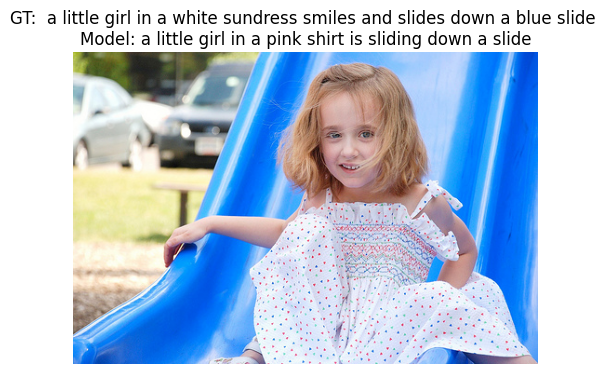

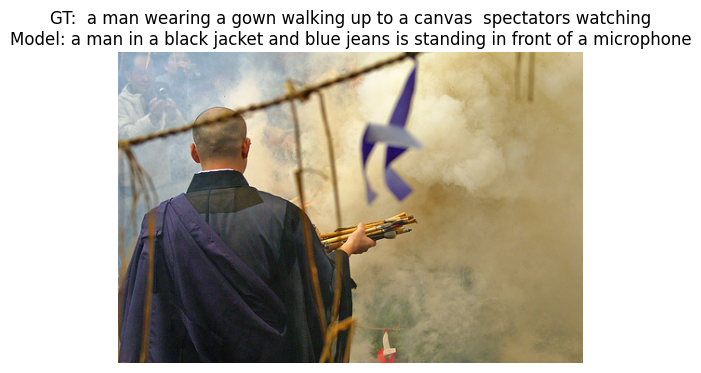

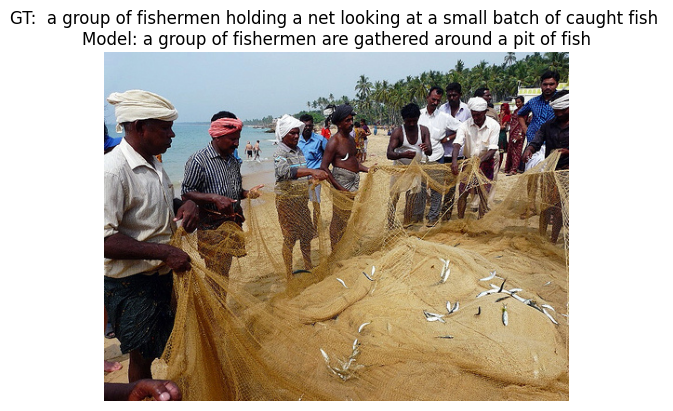

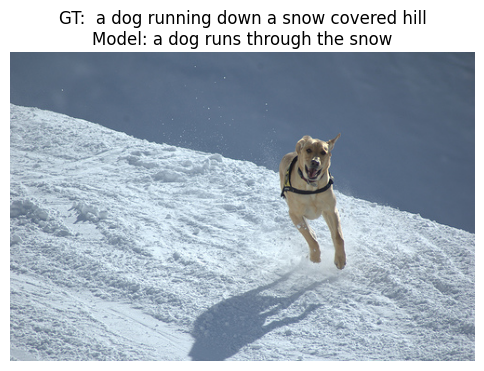

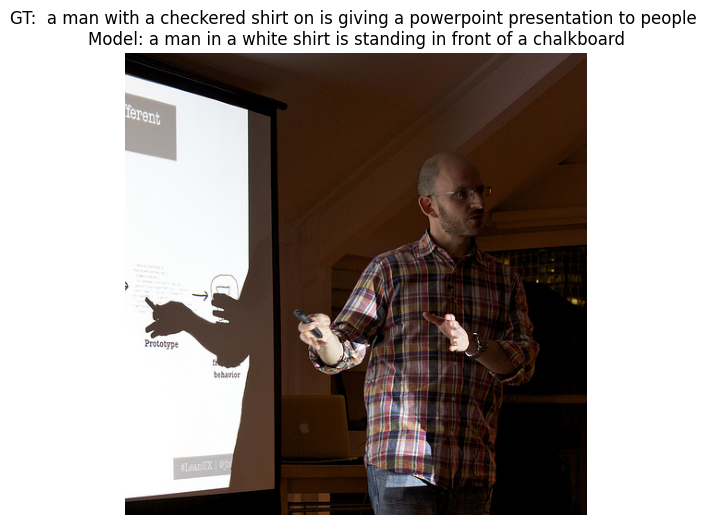

In [ ]:
def show_random_results_refined(df, features_dict, model, vocab, num_images=5):
    img_col = 'image_name' if 'image_name' in df.columns else 'image'
    cap_col = 'caption'

    random_indices = random.sample(range(len(df)), num_images)

    for idx in random_indices:
        img_name = df.iloc[idx][img_col]
        ground_truth = df.iloc[idx][cap_col]

        if img_name in features_dict:
            feature = features_dict[img_name]
            # Yahan naya function call ho raha hai
            generated_caption = caption_image_refined(model, feature, vocab)

            img_path = f'/kaggle/input/flickr30k/Images/{img_name}'
            if os.path.exists(img_path):
                img = Image.open(img_path)
                plt.figure(figsize=(6, 6))
                plt.imshow(img)
                plt.title(f"GT: {ground_truth}\nModel: {generated_caption}")
                plt.axis("off")
                plt.show()

show_random_results_refined(df, features_dict, model, vocab)

### Quantitative Evaluation (BLEU Score)

--> 0n 5 epochs model

In [ ]:
from nltk.translate.bleu_score import sentence_bleu
import random

def calculate_bleu(df, features_dict, model, vocab):
    # Model ko evaluation mode mein set krain
    model.eval()
    bleu_scores = []

    img_col = 'image_name' if 'image_name' in df.columns else 'image'
    cap_col = 'caption'

    # Hum first 100 random samples par check krtay hain for speed
    indices = random.sample(range(len(df)), 100)

    for idx in indices:
        img_name = df.iloc[idx][img_col]
        ground_truth = df.iloc[idx][cap_col].split()

        feature = features_dict[img_name]
        generated = caption_image(model, feature, vocab).split()

        # BLEU-4 calculation
        # Weights (0.25 each) for n-grams up to 4
        score = sentence_bleu([ground_truth], generated, weights=(0.25, 0.25, 0.25, 0.25))
        bleu_scores.append(score)

    avg_bleu = sum(bleu_scores) / len(bleu_scores)
    print(f"Average BLEU-4 Score on 100 samples: {avg_bleu:.4f}")

# Calculate the score
calculate_bleu(df, features_dict, model, vocab)

/usr/local/lib/python3.12/dist-packages/nltk/translate/bleu_score.py:577: UserWarning: 
The hypothesis contains 0 counts of 3-gram overlaps.
Therefore the BLEU score evaluates to 0, independently of
how many N-gram overlaps of lower order it contains.
Consider using lower n-gram order or use SmoothingFunction()
  warnings.warn(_msg)
/usr/local/lib/python3.12/dist-packages/nltk/translate/bleu_score.py:577: UserWarning: 
The hypothesis contains 0 counts of 4-gram overlaps.
Therefore the BLEU score evaluates to 0, independently of
how many N-gram overlaps of lower order it contains.
Consider using lower n-gram order or use SmoothingFunction()
  warnings.warn(_msg)
/usr/local/lib/python3.12/dist-packages/nltk/translate/bleu_score.py:577: UserWarning: 
The hypothesis contains 0 counts of 2-gram overlaps.
Therefore the BLEU score evaluates to 0, independently of
how many N-gram overlaps of lower order it contains.
Consider using lower n-gram order or use SmoothingFunction()
  warnings.warn(_

Average BLEU-4 Score on 100 samples: 0.0205


--> On 15 epoch model

In [ ]:
from nltk.translate.bleu_score import sentence_bleu
import random

def calculate_bleu(df, features_dict, model, vocab):
    # Model ko evaluation mode mein set krain
    model.eval()
    bleu_scores = []

    img_col = 'image_name' if 'image_name' in df.columns else 'image'
    cap_col = 'caption'

    # Hum first 100 random samples par check krtay hain for speed
    indices = random.sample(range(len(df)), 100)

    for idx in indices:
        img_name = df.iloc[idx][img_col]
        ground_truth = df.iloc[idx][cap_col].split()

        feature = features_dict[img_name]
        generated = caption_image(model, feature, vocab).split()

        # BLEU-4 calculation
        # Weights (0.25 each) for n-grams up to 4
        score = sentence_bleu([ground_truth], generated, weights=(0.25, 0.25, 0.25, 0.25))
        bleu_scores.append(score)

    avg_bleu = sum(bleu_scores) / len(bleu_scores)
    print(f"Average BLEU-4 Score on 100 samples: {avg_bleu:.4f}")

# Calculate the score
calculate_bleu(df, features_dict, model, vocab)

/usr/local/lib/python3.12/dist-packages/nltk/translate/bleu_score.py:577: UserWarning: 
The hypothesis contains 0 counts of 3-gram overlaps.
Therefore the BLEU score evaluates to 0, independently of
how many N-gram overlaps of lower order it contains.
Consider using lower n-gram order or use SmoothingFunction()
  warnings.warn(_msg)
/usr/local/lib/python3.12/dist-packages/nltk/translate/bleu_score.py:577: UserWarning: 
The hypothesis contains 0 counts of 4-gram overlaps.
Therefore the BLEU score evaluates to 0, independently of
how many N-gram overlaps of lower order it contains.
Consider using lower n-gram order or use SmoothingFunction()
  warnings.warn(_msg)
/usr/local/lib/python3.12/dist-packages/nltk/translate/bleu_score.py:577: UserWarning: 
The hypothesis contains 0 counts of 2-gram overlaps.
Therefore the BLEU score evaluates to 0, independently of
how many N-gram overlaps of lower order it contains.
Consider using lower n-gram order or use SmoothingFunction()
  warnings.warn(_

Average BLEU-4 Score on 100 samples: 0.0278


--> On 25 epoch model

In [ ]:
from nltk.translate.bleu_score import sentence_bleu
import random

def calculate_bleu(df, features_dict, model, vocab):
    # Model ko evaluation mode mein set krain
    model.eval()
    bleu_scores = []

    img_col = 'image_name' if 'image_name' in df.columns else 'image'
    cap_col = 'caption'

    # Hum first 100 random samples par check krtay hain for speed
    indices = random.sample(range(len(df)), 100)

    for idx in indices:
        img_name = df.iloc[idx][img_col]
        ground_truth = df.iloc[idx][cap_col].split()

        feature = features_dict[img_name]
        generated = caption_image(model, feature, vocab).split()

        # BLEU-4 calculation
        # Weights (0.25 each) for n-grams up to 4
        score = sentence_bleu([ground_truth], generated, weights=(0.25, 0.25, 0.25, 0.25))
        bleu_scores.append(score)

    avg_bleu = sum(bleu_scores) / len(bleu_scores)
    print(f"Average BLEU-4 Score on 100 samples: {avg_bleu:.4f}")

# Calculate the score
calculate_bleu(df, features_dict, model, vocab)

/usr/local/lib/python3.12/dist-packages/nltk/translate/bleu_score.py:577: UserWarning: 
The hypothesis contains 0 counts of 3-gram overlaps.
Therefore the BLEU score evaluates to 0, independently of
how many N-gram overlaps of lower order it contains.
Consider using lower n-gram order or use SmoothingFunction()
  warnings.warn(_msg)
/usr/local/lib/python3.12/dist-packages/nltk/translate/bleu_score.py:577: UserWarning: 
The hypothesis contains 0 counts of 4-gram overlaps.
Therefore the BLEU score evaluates to 0, independently of
how many N-gram overlaps of lower order it contains.
Consider using lower n-gram order or use SmoothingFunction()
  warnings.warn(_msg)
/usr/local/lib/python3.12/dist-packages/nltk/translate/bleu_score.py:577: UserWarning: 
The hypothesis contains 0 counts of 2-gram overlaps.
Therefore the BLEU score evaluates to 0, independently of
how many N-gram overlaps of lower order it contains.
Consider using lower n-gram order or use SmoothingFunction()
  warnings.warn(_

Average BLEU-4 Score on 100 samples: 0.0236


## Beam Search Implementation

In [ ]:
def beam_search_caption(model, feature, vocab, beam_size=3, max_length=50):
    """
    Generate a caption using Beam Search to improve sentence quality.
    """
    model.eval()

    # Prepare initial feature vector
    # Image features ko Encoder se pass kar ke initial state banayen gay [cite: 81, 86]
    feature = torch.tensor(feature).unsqueeze(0).to(device)
    encoded_feature = model.encoderCNN(feature).unsqueeze(1)

    # Starting sequence: (log_probability, current_sentence, hidden_state)
    # Hum shuruat <start> token se krain gay
    start_token = vocab.stoi["<start>"]
    beams = [(0, [start_token], None)]

    completed_sequences = []

    with torch.no_grad():
        for _ in range(max_length):
            new_beams = []
            for score, seq, states in beams:
                # Agar sequence pehlay hi <end> par khatam ho chuki hai
                if seq[-1] == vocab.stoi["<end>"]:
                    completed_sequences.append((score, seq))
                    continue

                # Input for current step
                if len(seq) == 1:
                    # Pehla step: Image features input hon gay [cite: 84]
                    hiddens, new_states = model.decoderRNN.lstm(encoded_feature, states)
                else:
                    # Aglay steps: Pichla predicted word input ho ga
                    last_word = torch.tensor([seq[-1]]).to(device).unsqueeze(0)
                    embeddings = model.decoderRNN.embed(last_word)
                    hiddens, new_states = model.decoderRNN.lstm(embeddings, states)

                # Get probabilities for all words [cite: 87]
                output = model.decoderRNN.linear(hiddens.squeeze(1))
                log_probs = torch.log_softmax(output, dim=1)

                # Top k candidates select krain (k = beam_size)
                top_probs, top_indices = log_probs.topk(beam_size)

                for i in range(beam_size):
                    new_score = score + top_probs[0][i].item()
                    new_seq = seq + [top_indices[0][i].item()]
                    new_beams.append((new_score, new_seq, new_states))

            # Sirf top beam_size sequences ko agay le kar jayen
            beams = sorted(new_beams, key=lambda x: x[0], reverse=True)[:beam_size]

            # Agar saari sequences khatam ho chuki hain
            if all(s[-1] == vocab.stoi["<end>"] for _, s, _ in beams):
                break

        # Final score calculation
        completed_sequences.extend([(s, seq) for s, seq, _ in beams])
        completed_sequences.sort(key=lambda x: x[0], reverse=True)

        # Best sequence uthayen aur tokens ko words mein convert krain
        best_seq = completed_sequences[0][1]
        final_caption = [vocab.itos[idx] for idx in best_seq if idx not in [vocab.stoi["<start>"], vocab.stoi["<end>"], vocab.stoi["<pad>"]]]

        return ' '.join(final_caption)

print("Beam Search function is ready!")

Beam Search function is ready!


### Compare Greedy vs Beam Search

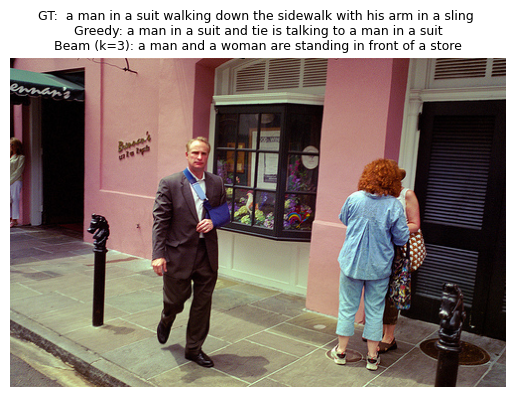

In [ ]:
def compare_search_methods(df, features_dict, model, vocab, beam_size=3):
    img_col = 'image_name' if 'image_name' in df.columns else 'image'
    cap_col = 'caption'

    # Pick a random test image
    idx = random.randint(0, len(df)-1)
    img_name = df.iloc[idx][img_col]
    ground_truth = df.iloc[idx][cap_col]
    feature = features_dict[img_name]

    # Generate using both methods
    greedy_cap = caption_image_refined(model, feature, vocab)
    beam_cap = beam_search_caption(model, feature, vocab, beam_size=beam_size)

    # Display
    img_path = f'/kaggle/input/flickr30k/Images/{img_name}'
    img = Image.open(img_path)
    plt.imshow(img)
    plt.title(f"GT: {ground_truth}\nGreedy: {greedy_cap}\nBeam (k={beam_size}): {beam_cap}", fontsize=9)
    plt.axis("off")
    plt.show()

# Run the comparison
compare_search_methods(df, features_dict, model, vocab)

# Random Comparison (Greedy & Beam) on 15 Epoch

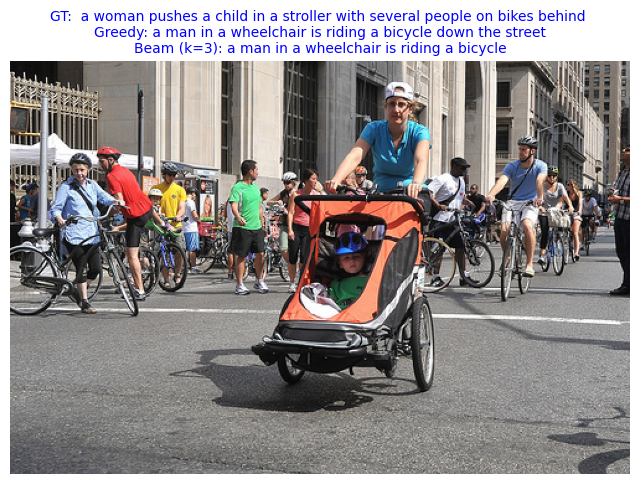

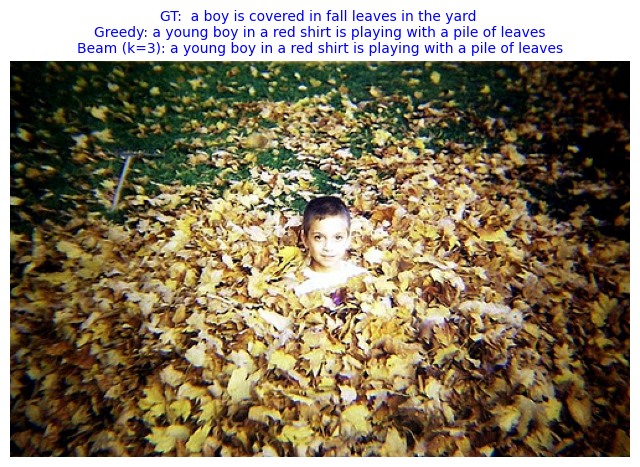

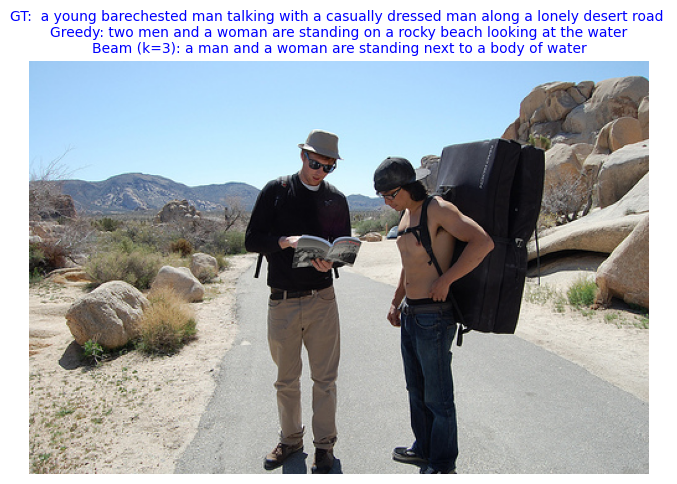

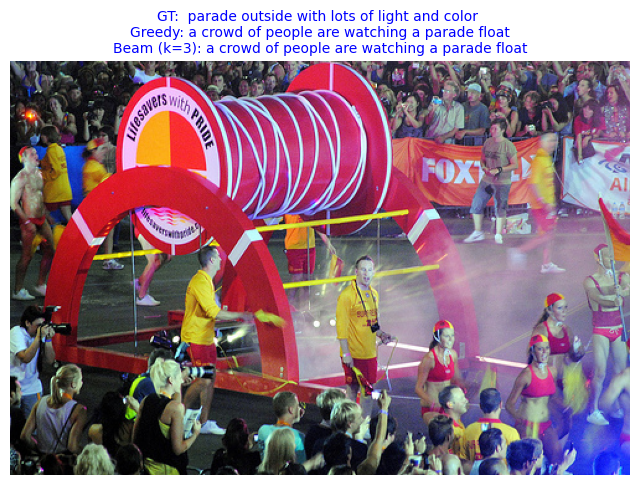

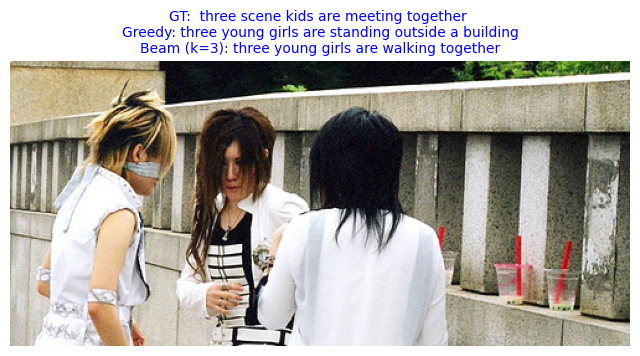

In [ ]:
import random
import os
from PIL import Image
import matplotlib.pyplot as plt

def run_random_comparisons(df, features_dict, model, vocab, num_images=5, beam_size=3):
    """
    Pick random images and compare Greedy vs Beam Search predictions.
    """
    img_col = 'image_name' if 'image_name' in df.columns else 'image'
    cap_col = 'caption'

    # Selecting random samples
    indices = random.sample(range(len(df)), num_images)

    for idx in indices:
        img_name = df.iloc[idx][img_col]
        ground_truth = df.iloc[idx][cap_col]

        if img_name in features_dict:
            feature = features_dict[img_name]

            # Generate using both methods
            # Greedy prediction (using the refined function)
            greedy_output = caption_image_refined(model, feature, vocab)

            # Beam Search prediction
            beam_output = beam_search_caption(model, feature, vocab, beam_size=beam_size)

            # Image path
            img_path = f'/kaggle/input/flickr30k/Images/{img_name}'

            if os.path.exists(img_path):
                img = Image.open(img_path)
                plt.figure(figsize=(8, 8))
                plt.imshow(img)
                plt.title(f"GT: {ground_truth}\nGreedy: {greedy_output}\nBeam (k={beam_size}): {beam_output}",
                          fontsize=10, color='blue')
                plt.axis("off")
                plt.show()

# Is cell ko run kar ke 5 comparisons check krain
run_random_comparisons(df, features_dict, model, vocab)

## Quantitative Evaluation (BLEU, Precision, Recall, F1)

Precision: Model ne jo words kahe, un mein se kitne sahi hain.

Recall: Ground truth ke kitne words model ne pick kiye.

F1-Score: Precision aur Recall ka balance.


BLEU-4: N-grams (4 words ka sequence) ki matching check karta hai.

In [ ]:
from nltk.translate.bleu_score import sentence_bleu, SmoothingFunction
from sklearn.metrics import precision_score, recall_score, f1_score
import numpy as np

def calculate_all_metrics(df, features_dict, model, vocab, num_samples=100):
    model.eval()
    img_col = 'image_name' if 'image_name' in df.columns else 'image'
    cap_col = 'caption'

    bleu_scores = []
    all_precisions = []
    all_recalls = []
    all_f1s = []

    indices = random.sample(range(len(df)), num_samples)
    smoothie = SmoothingFunction().method4 # To handle short captions

    print(f"Calculating metrics for {num_samples} samples...")

    for idx in indices:
        img_name = df.iloc[idx][img_col]
        # Ground truth and prediction as lists of tokens
        reference = df.iloc[idx][cap_col].split()
        candidate = beam_search_caption(model, features_dict[img_name], vocab).split()

        # 1. BLEU-4 Score
        score = sentence_bleu([reference], candidate, weights=(0.25, 0.25, 0.25, 0.25), smoothing_function=smoothie)
        bleu_scores.append(score)

        # 2. Token-level Precision, Recall, F1
        # We use sets of words to compare overlapping tokens
        ref_set = set(reference)
        cand_set = set(candidate)

        if len(cand_set) == 0:
            p, r, f = 0, 0, 0
        else:
            tp = len(ref_set.intersection(cand_set)) # True Positives
            p = tp / len(cand_set)
            r = tp / len(ref_set)
            f = (2 * p * r) / (p + r) if (p + r) > 0 else 0

        all_precisions.append(p)
        all_recalls.append(r)
        all_f1s.append(f)

    print("-" * 30)
    print(f"Average BLEU-4 Score: {np.mean(bleu_scores):.4f}")
    print(f"Average Precision:   {np.mean(all_precisions):.4f}")
    print(f"Average Recall:      {np.mean(all_recalls):.4f}")
    print(f"Average F1-Score:    {np.mean(all_f1s):.4f}")
    print("-" * 30)

# Run the evaluation
calculate_all_metrics(df, features_dict, model, vocab)

Calculating metrics for 100 samples...
------------------------------
Average BLEU-4 Score: 0.0773
Average Precision:   0.4124
Average Recall:      0.3311
Average F1-Score:    0.3527
------------------------------


# --> Comparsion Greedy vs Beam on 25 Epoch

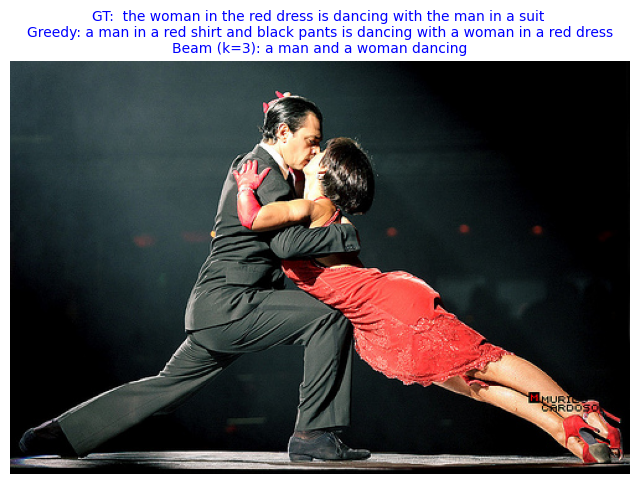

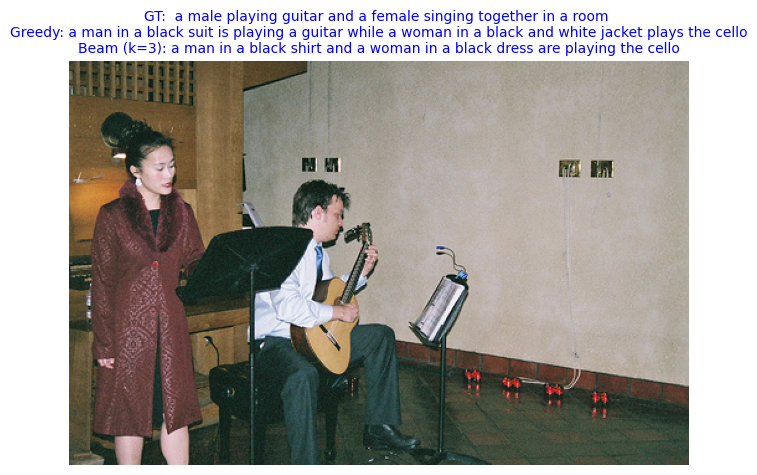

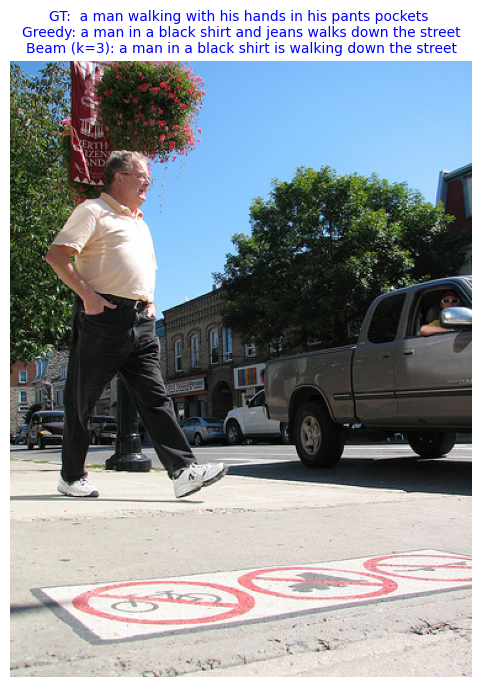

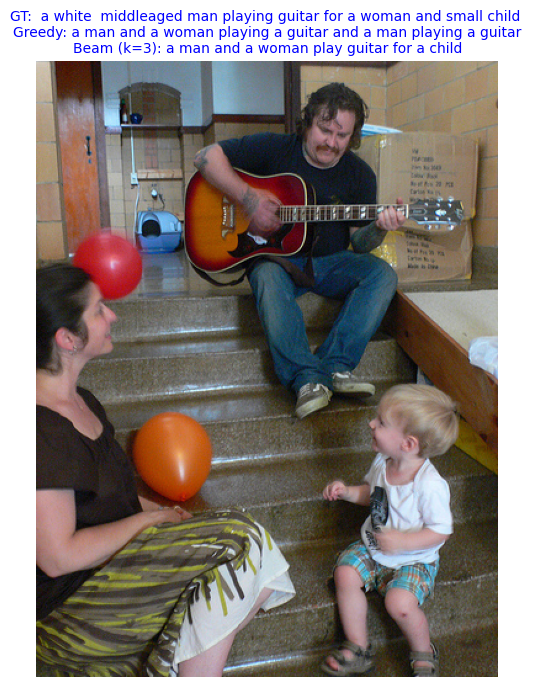

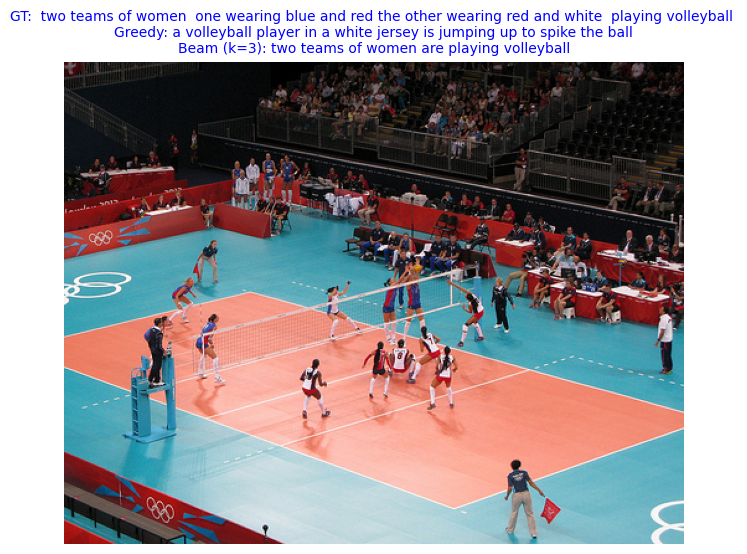

In [ ]:
def run_random_comparisons(df, features_dict, model, vocab, num_images=5, beam_size=3):
    """
    Pick random images and compare Greedy vs Beam Search predictions.
    """
    img_col = 'image_name' if 'image_name' in df.columns else 'image'
    cap_col = 'caption'

    # Selecting random samples
    indices = random.sample(range(len(df)), num_images)

    for idx in indices:
        img_name = df.iloc[idx][img_col]
        ground_truth = df.iloc[idx][cap_col]

        if img_name in features_dict:
            feature = features_dict[img_name]

            # Generate using both methods
            # Greedy prediction (using the refined function)
            greedy_output = caption_image_refined(model, feature, vocab)

            # Beam Search prediction
            beam_output = beam_search_caption(model, feature, vocab, beam_size=beam_size)

            # Image path
            img_path = f'/kaggle/input/flickr30k/Images/{img_name}'

            if os.path.exists(img_path):
                img = Image.open(img_path)
                plt.figure(figsize=(8, 8))
                plt.imshow(img)
                plt.title(f"GT: {ground_truth}\nGreedy: {greedy_output}\nBeam (k={beam_size}): {beam_output}",
                          fontsize=10, color='blue')
                plt.axis("off")
                plt.show()

# Is cell ko run kar ke 5 comparisons check krain
run_random_comparisons(df, features_dict, model, vocab)

## Quantitative Evaluation (BLEU, Precision, Recall, F1)

In [ ]:
from nltk.translate.bleu_score import sentence_bleu, SmoothingFunction
from sklearn.metrics import precision_score, recall_score, f1_score
import numpy as np

def calculate_all_metrics(df, features_dict, model, vocab, num_samples=100):
    model.eval()
    img_col = 'image_name' if 'image_name' in df.columns else 'image'
    cap_col = 'caption'

    bleu_scores = []
    all_precisions = []
    all_recalls = []
    all_f1s = []

    indices = random.sample(range(len(df)), num_samples)
    smoothie = SmoothingFunction().method4 # To handle short captions

    print(f"Calculating metrics for {num_samples} samples...")

    for idx in indices:
        img_name = df.iloc[idx][img_col]
        # Ground truth and prediction as lists of tokens
        reference = df.iloc[idx][cap_col].split()
        candidate = beam_search_caption(model, features_dict[img_name], vocab).split()

        # 1. BLEU-4 Score
        score = sentence_bleu([reference], candidate, weights=(0.25, 0.25, 0.25, 0.25), smoothing_function=smoothie)
        bleu_scores.append(score)

        # 2. Token-level Precision, Recall, F1
        # We use sets of words to compare overlapping tokens
        ref_set = set(reference)
        cand_set = set(candidate)

        if len(cand_set) == 0:
            p, r, f = 0, 0, 0
        else:
            tp = len(ref_set.intersection(cand_set)) # True Positives
            p = tp / len(cand_set)
            r = tp / len(ref_set)
            f = (2 * p * r) / (p + r) if (p + r) > 0 else 0

        all_precisions.append(p)
        all_recalls.append(r)
        all_f1s.append(f)

    print("-" * 30)
    print(f"Average BLEU-4 Score: {np.mean(bleu_scores):.4f}")
    print(f"Average Precision:   {np.mean(all_precisions):.4f}")
    print(f"Average Recall:      {np.mean(all_recalls):.4f}")
    print(f"Average F1-Score:    {np.mean(all_f1s):.4f}")
    print("-" * 30)

# Run the evaluation
calculate_all_metrics(df, features_dict, model, vocab)

Calculating metrics for 100 samples...
------------------------------
Average BLEU-4 Score: 0.1079
Average Precision:   0.4277
Average Recall:      0.3568
Average F1-Score:    0.3743
------------------------------


## Model Save

In [ ]:
# Save the model state and vocabulary for the app
checkpoint = {
    "state_dict": model.state_dict(),
    "optimizer": optimizer.state_dict(),
    "vocab": vocab,
    "embed_size": embed_size,
    "hidden_size": hidden_size,
    "num_layers": num_layers
}
torch.save(checkpoint, "flickr30k_model.pth")
print("Model and Vocab saved successfully as 'flickr30k_model.pth'!")

Model and Vocab saved successfully as 'flickr30k_model.pth'!


### Model and Features Download

In [ ]:
from google.colab import files

# Downloading the trained model weights
print("Downloading model weights...")
files.download('flickr30k_model.pth')

# Downloading the extracted image features
print("Downloading features pickle file...")
files.download('flickr30k_features.pkl')

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

### App Deployment

In [ ]:
import gradio as gr

def predict_caption_v2(input_image, search_method):
    """
    Enhanced prediction function with Greedy and Beam Search options.
    """
    # 1. Image Preprocessing
    transform = transforms.Compose([
        transforms.Resize((224, 224)),
        transforms.ToTensor(),
        transforms.Normalize((0.485, 0.456, 0.406), (0.229, 0.224, 0.225))
    ])
    img_t = transform(input_image).unsqueeze(0).to(device)

    # 2. Feature Extraction
    with torch.no_grad():
        # Using the feature extractor part of our architecture
        cnn_model = models.resnet50(weights=models.ResNet50_Weights.DEFAULT)
        cnn_model = nn.Sequential(*list(cnn_model.children())[:-1]).to(device)
        cnn_model.eval()
        feature = cnn_model(img_t).view(1, -1).cpu().numpy()

    # 3. Search Method Selection
    # User ki choice ke mutabiq method select ho ga
    if search_method == "Greedy":
        caption = caption_image_refined(model, feature.squeeze(0), vocab)
    else:
        caption = beam_search_caption(model, feature.squeeze(0), vocab, beam_size=3)

    return caption

# Gradio Interface Setup
# Adding Radio buttons and adjusting text box size
interface = gr.Interface(
    fn=predict_caption_v2,
    inputs=[
        gr.Image(type="pil", label="Upload Image"),
        gr.Radio(["Greedy", "Beam Search"], label="Select Search Method", value="Beam Search")
    ],
    outputs=gr.Textbox(label="Generated Caption", lines=3, interactive=False),
    title="Neural Storyteller - Generative AI",
    description="Choose a method and upload an image to generate a caption."
)

interface.launch(share=True)

Colab notebook detected. To show errors in colab notebook, set debug=True in launch()
* Running on public URL: https://bfea301afdd97ed03e.gradio.live

This share link expires in 1 week. For free permanent hosting and GPU upgrades, run `gradio deploy` from the terminal in the working directory to deploy to Hugging Face Spaces (https://huggingface.co/spaces)


---> ON 15 Epoch Results:

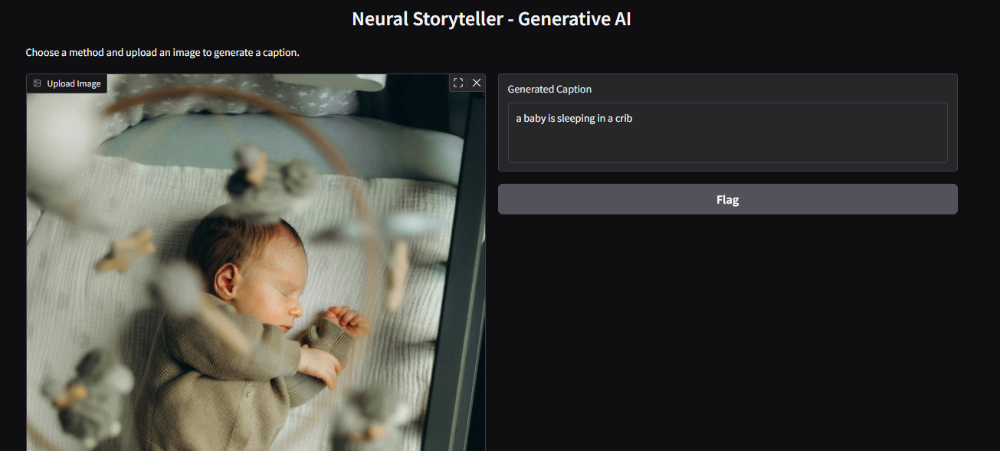

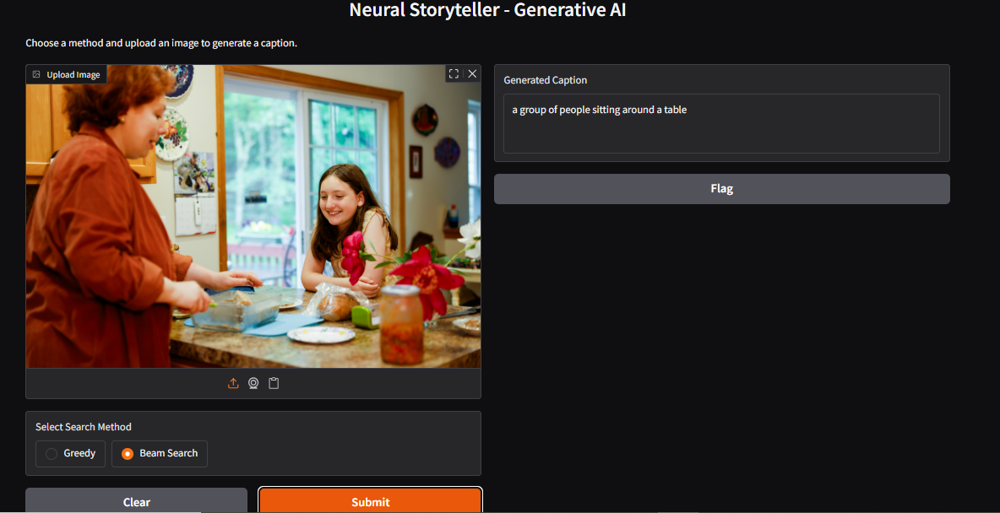

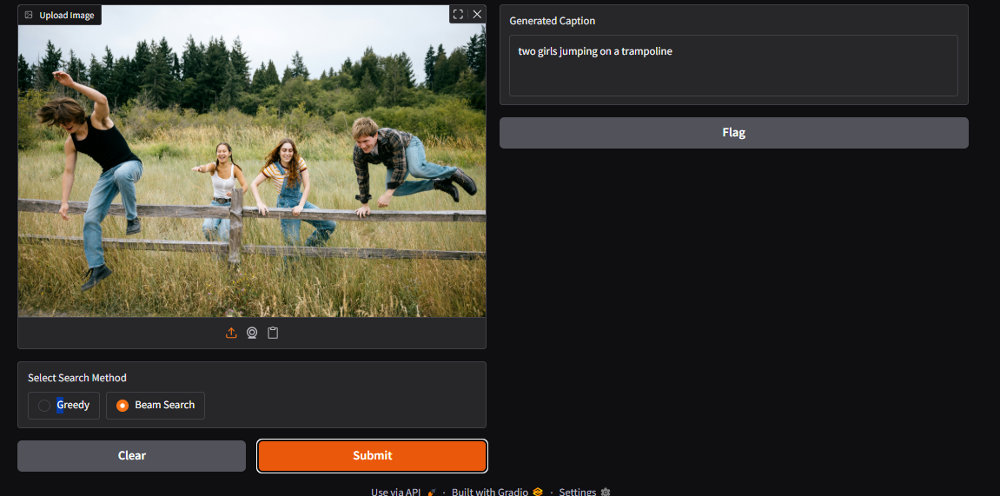

--> On 25 Epoch Test

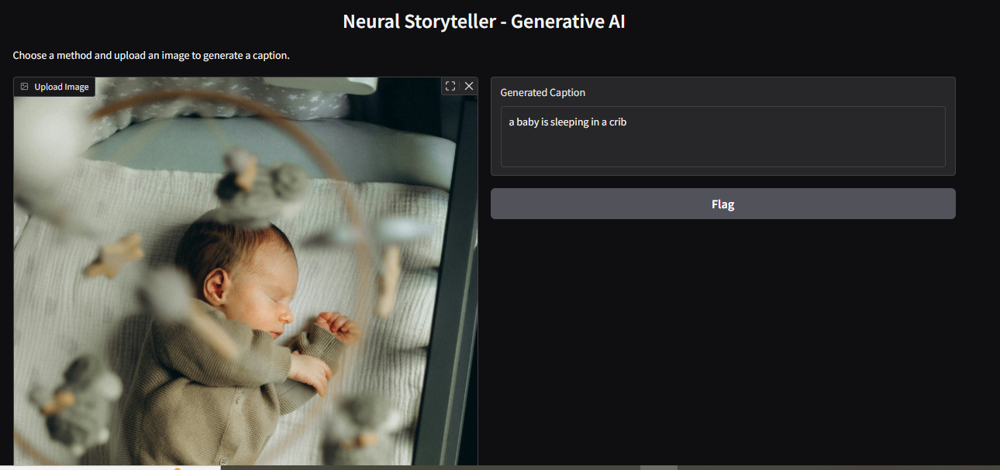

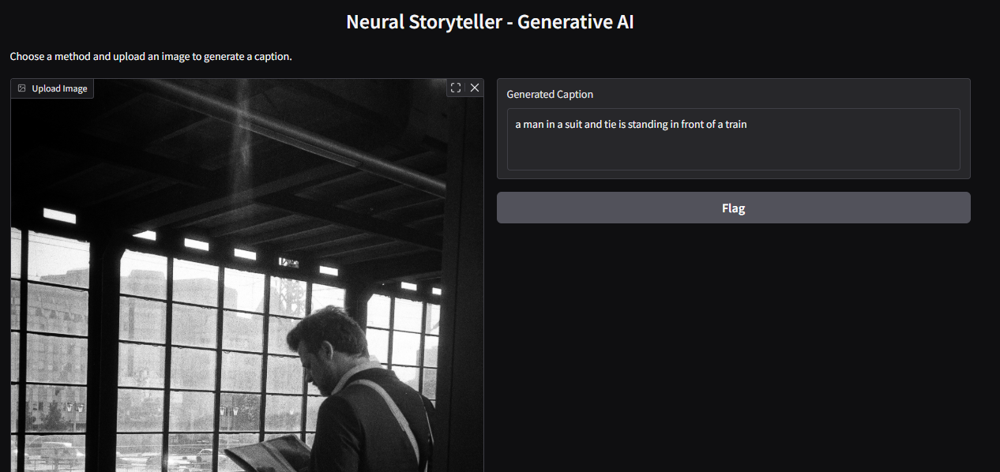

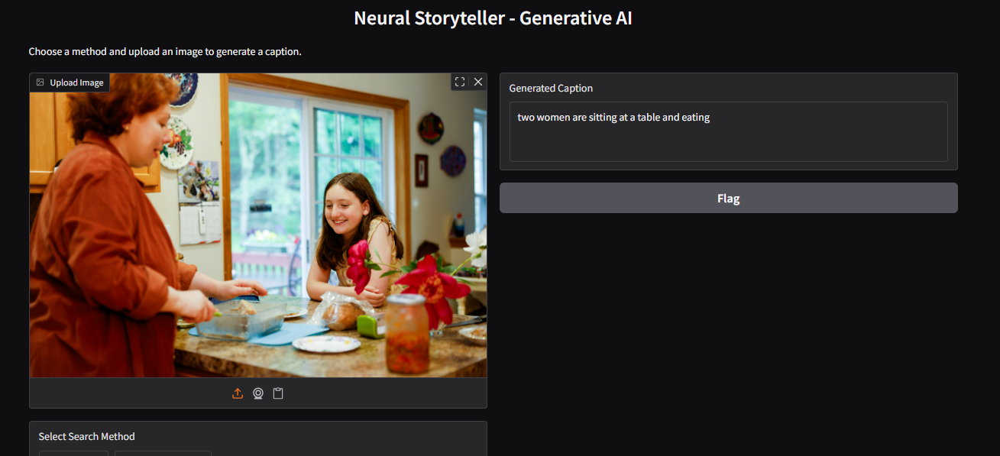

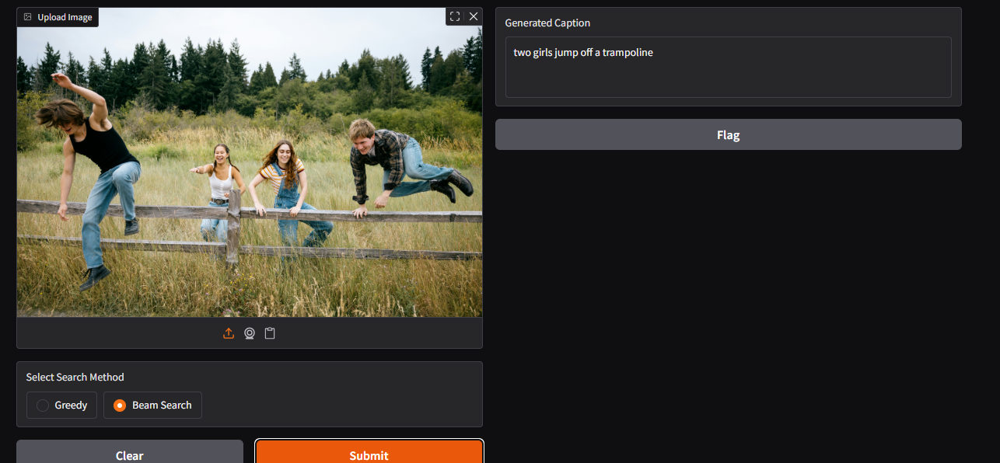